# **1. Import and Install Dependencies**

## **1.1 Install Dependencies**

In [ ]:
!pip install tensorflow==2.14.0

In [ ]:
!pip install matplotlib

## **1.2 Load Dependencies**

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Embedding, MultiHeadAttention, LayerNormalization, Dropout, Dense
from tensorflow.keras.models import Sequential
print(f'TensorFlow Version {tf.__version__}')

TensorFlow Version 2.14.0


In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

In [ ]:
import os
import matplotlib.pyplot as plt
import numpy as np
import datetime
# import librosa     Only needed for BPMs

In [ ]:
# Load the TensorBoard notebook extension
%reload_ext tensorboard

In [ ]:
# Clear any logs from previous runs
!rm -rf ./logs/

# **2. Build Data Loading Function**

## **2.1 Define Paths to Files**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!ls

drive  sample_data


## **2.2 Build Dataloading Function**

In [ ]:
def load_wav_mono(filename):
  # Load encoded wav file
  file_contents = tf.io.read_file(filename)
  # Decode wav (tensors by channels)
  wav, sample_rate = tf.audio.decode_wav(file_contents, desired_channels=1)
  # Removes trailing axis
  wav = tf.squeeze(wav, axis=-1)
  return wav

# **3. Define Paths to Data**

In [ ]:
MUSIC_DATA_PATH = os.path.join('drive', 'MyDrive', 'Data', 'Songs')

In [ ]:
file_paths = [os.path.join(MUSIC_DATA_PATH, file) for file in os.listdir(MUSIC_DATA_PATH)]

In [ ]:
for item in file_paths:
  print(item)

drive/MyDrive/Data/Songs/BROHUG - Addict.wav


# **4. Determine BPMs of Songs**

In [ ]:
"""BPMs = []
for file in os.listdir(os.path.join('drive', 'MyDrive', 'Data', 'Songs')):
  y, sr = librosa.load(os.path.join('drive', 'MyDrive', 'Data', 'Songs', file))
  tempo, _ = librosa.beat.beat_track(y=y, sr=sr)
  BPMs.append(tempo)"""

"BPMs = []\nfor file in os.listdir(os.path.join('drive', 'MyDrive', 'Data', 'Songs')):\n  y, sr = librosa.load(os.path.join('drive', 'MyDrive', 'Data', 'Songs', file))\n  tempo, _ = librosa.beat.beat_track(y=y, sr=sr)\n  BPMs.append(tempo)"

# **5. Hyperparameters**

## **5.1 Data Params**

In [ ]:
FRAME_LENGTH = 10000
FRAME_STEP = 2000

In [ ]:
CONTEXT_SIZE = 125                        # Number of tokens to consider in input
TOKENS_TO_PREDICT = 125                   # Number of tokens to generate in output
WINDOW_SIZE = CONTEXT_SIZE + TOKENS_TO_PREDICT

BATCH_SIZE = 32                           # Batch size

In [ ]:
SAMPLE_JUMP = 5

In [ ]:
INPUT_VOCAB_SIZE = 6829
OUTPUT_VOCAB_SIZE = 6829

#LENGTH_IN_SECONDS = np.shape(load_wav_mono(path).numpy())[0] / 48000
#TOKENS_PER_SONG = numTimes
#TOKENS_PER_SECOND = int(np.round(TOKENS_PER_SONG / LENGTH_IN_SECONDS))

#print(TOKENS_PER_SECOND)

## **5.2 Model Params**

In [ ]:
D_MODEL = INPUT_VOCAB_SIZE                # Model dimension
FEATURE_EMBEDDINGS = 512                  # Number of features in secondary embedding layer
NUM_HEADS = 16                            # Number of heads
D_K = FEATURE_EMBEDDINGS // NUM_HEADS     # Dimension of Q and K
D_V = D_K                                 # Dimension of V
D_FF = 1024                               # Number of neurons in Feed Forward layer

NUM_LAYERS = 4                            # Number of Encoder/Decoder Stacks
DROPOUT_RATE = 0.1                        # Global dropout rate
EPSILON = 0.000001                        # Constant added to ensure nonzero values
WARMUP_STEPS = 1500                       # Warmup (linear increase in learning rate) steps before cooldown
NUM_EPOCHS = 250                          # Number of epochs to train for

# **6. Build Preprocessing Pipeline**

In [ ]:
def preprocess(filepath):
  # Load Wav
  wav = load_wav_mono(filepath)

  # STFT
  spectrogram = tf.abs(tf.signal.stft(wav, frame_length=FRAME_LENGTH, frame_step=FRAME_STEP))
  spectrogram = tf.expand_dims(spectrogram, axis=-1)
  spectrogram = tf.expand_dims(spectrogram, axis=0)
  spectrogram = spectrogram[:, :, :6828, :]

  # Create Patches
  test = tf.image.extract_patches(images=spectrogram,
                                  sizes=[1, WINDOW_SIZE, 6828, 1],
                                  strides=[1, SAMPLE_JUMP, 1, 1],
                                  rates=[1, 1, 1, 1],
                                  padding='VALID')
  test = tf.reshape(test, [-1, WINDOW_SIZE, 6828])
  test = tf.pad(test, paddings=[[0, 0], [0, 0], [0, 1]], constant_values=0.0)

  # Inputs
  inputs = test[:, :CONTEXT_SIZE, :]

  # Targets
  labels = test[:, CONTEXT_SIZE:, :]

  # Labels
  targets = labels[:, :-1, :]

  return ((inputs, targets), labels)

# **7. Data for Model**

## **7.1 Create Dataset**

In [ ]:
dataset = tf.data.Dataset.from_tensor_slices(file_paths)
dataset = dataset.map(preprocess, num_parallel_calls=tf.data.AUTOTUNE)
dataset = dataset.unbatch()

## **7.2 Partition Data Into Train/Test**

In [ ]:
num_samples = 0

for item in dataset:
  num_samples += 1

num_samples

799

In [ ]:
dataset = dataset.shuffle(buffer_size=num_samples*3)

In [ ]:
train_size = int(0.8 * num_samples)
test_size = num_samples - train_size

In [ ]:
# Split the dataset
train_dataset = dataset.take(train_size)
test_dataset = dataset.skip(train_size)

In [ ]:
# Cache the datasets
train_dataset = train_dataset.cache()
test_dataset = test_dataset.cache()

In [ ]:
# Batch data
train_dataset = train_dataset.batch(BATCH_SIZE)
test_dataset = test_dataset.batch(BATCH_SIZE)

In [ ]:
# Add prefetching
train_dataset = train_dataset.prefetch(tf.data.AUTOTUNE)
test_dataset = test_dataset.prefetch(tf.data.AUTOTUNE)

In [ ]:
train_dataset

<_PrefetchDataset element_spec=((TensorSpec(shape=(None, 125, 6829), dtype=tf.float32, name=None), TensorSpec(shape=(None, 124, 6829), dtype=tf.float32, name=None)), TensorSpec(shape=(None, 125, 6829), dtype=tf.float32, name=None))>

In [ ]:
test_dataset

<_PrefetchDataset element_spec=((TensorSpec(shape=(None, 125, 6829), dtype=tf.float32, name=None), TensorSpec(shape=(None, 124, 6829), dtype=tf.float32, name=None)), TensorSpec(shape=(None, 125, 6829), dtype=tf.float32, name=None))>

# **8. Build and Test Functions for Transformer Model**

## **8.1 Grab a Batch For Testing**

In [ ]:
for (batch, ((x_batch_train, y_batch_train), true_y_batch_train)) in enumerate(train_dataset):
  break

In [ ]:
print(x_batch_train.shape)
print(y_batch_train.shape)
print(true_y_batch_train.shape)

(32, 125, 6829)
(32, 124, 6829)
(32, 125, 6829)


## **8.2 Embeddings**

In [ ]:
def positional_encoding(length, depth):
  depth = depth/2

  positions = np.arange(length)[:, np.newaxis]     # (seq, 1)
  depths = np.arange(depth)[np.newaxis, :]/depth   # (1, depth)

  angle_rates = 1 / (10000**depths)         # (1, depth)
  angle_rads = positions * angle_rates      # (pos, depth)

  pos_encoding = np.concatenate(
      [np.sin(angle_rads), np.cos(angle_rads)],
      axis=-1)

  return tf.cast(pos_encoding, dtype=tf.float32)


class PositionalEmbedding(tf.keras.layers.Layer):
  def __init__(self, vocab_size, d_model, num_features):
    super().__init__()
    self.d_model = d_model
    self.num_features = num_features
    self.linear_layer = tf.keras.layers.Dense(num_features, use_bias=True, activation='relu')
    self.pos_encoding = positional_encoding(length=CONTEXT_SIZE, depth=num_features)

  def compute_mask(self, inputs, mask=None):
    # The mask returned by this layer is the same as the one received (identity mask).
    return mask

  def call(self, x, mask=None):
    length = tf.shape(x)[1]

    # Apply the linear layer to x
    x = self.linear_layer(x)

    x = x + self.pos_encoding[tf.newaxis, :length, :]
    return x

In [ ]:
class PositionalEmbeddingDec(tf.keras.layers.Layer):
  def __init__(self, vocab_size, d_model, num_features):
    super().__init__()
    self.d_model = d_model
    self.num_features = num_features
    self.linear_layer = tf.keras.layers.Dense(num_features, use_bias=True, activation='relu')
    self.pos_encoding = positional_encoding(length=CONTEXT_SIZE, depth=num_features)

  def compute_mask(self, inputs, mask=None):
    # The mask returned by this layer is the same as the one received (identity mask).
    return mask

  def call(self, x, mask=None):
    length = tf.shape(x)[1] + 1

    # Append start token
    start_token = tf.one_hot([6828], depth=6829, dtype=tf.float32)  # Assuming 6829 is the embedding size
    start_token = tf.expand_dims(start_token, axis=0)
    start_token = tf.tile(start_token, [tf.shape(x)[0], 1, 1])
    x = tf.concat([start_token, x], axis=1)

    # Apply the linear layer to x
    x = self.linear_layer(x)

    x = x + self.pos_encoding[tf.newaxis, :length, :]
    return x

In [ ]:
# We only use one embedder since the input and output vocab are the same
# (use two embedders if it's a vision transformer, one language to another
# language, etc)
enc_embed = PositionalEmbedding(vocab_size=INPUT_VOCAB_SIZE, d_model=D_MODEL, num_features=FEATURE_EMBEDDINGS)
dec_embed = PositionalEmbeddingDec(vocab_size=INPUT_VOCAB_SIZE, d_model=D_MODEL, num_features=FEATURE_EMBEDDINGS)

x_emb = enc_embed(x_batch_train)
y_emb = dec_embed(y_batch_train)

print(f'x_emb shape: {x_emb.shape}')
print(f'y_emb shape: {y_emb.shape}')

x_emb shape: (32, 125, 512)
y_emb shape: (32, 125, 512)


## **8.3 Attention Types**

In [ ]:
class BaseAttention(tf.keras.layers.Layer):
  def __init__(self, **kwargs):
    super().__init__()
    self.mha = tf.keras.layers.MultiHeadAttention(**kwargs)
    self.layernorm = tf.keras.layers.LayerNormalization()
    self.add = tf.keras.layers.Add()

In [ ]:
class CrossAttention(BaseAttention):
  def call(self, x, context):
    attn_output, attn_scores = self.mha(
        query=x,
        key=context,
        value=context,
        return_attention_scores=True)

    # Cache the attention scores for plotting later.
    self.last_attn_scores = attn_scores

    x = self.add([x, attn_output])
    x = self.layernorm(x)

    return x

In [ ]:
sample_ca = CrossAttention(num_heads=NUM_HEADS, key_dim=D_K)

print(sample_ca(x_emb, y_emb).shape)

(32, 125, 512)


In [ ]:
class GlobalSelfAttention(BaseAttention):
  def call(self, x):
    attn_output = self.mha(
        query=x,
        value=x,
        key=x)
    x = self.add([x, attn_output])
    x = self.layernorm(x)
    return x

In [ ]:
sample_gsa = GlobalSelfAttention(num_heads=NUM_HEADS, key_dim=D_K)

print(sample_gsa(x_emb).shape)

(32, 125, 512)


In [ ]:
class CausalSelfAttention(BaseAttention):
  def call(self, x):
    attn_output = self.mha(
        query=x,
        value=x,
        key=x,
        use_causal_mask = True)
    x = self.add([x, attn_output])
    x = self.layernorm(x)
    return x

In [ ]:
sample_csa = CausalSelfAttention(num_heads=NUM_HEADS, key_dim=D_K)

print(sample_csa(y_emb).shape)

(32, 125, 512)


## **8.4 Feed Forward**

In [ ]:
class FeedForward(tf.keras.layers.Layer):
  def __init__(self, num_features, dff, dropout_rate=0.1):
    super().__init__()
    self.seq = tf.keras.Sequential([
      tf.keras.layers.Dense(dff, activation='relu'),
      tf.keras.layers.Dense(num_features),
      tf.keras.layers.Dropout(dropout_rate)
    ])
    self.add = tf.keras.layers.Add()
    self.layer_norm = tf.keras.layers.LayerNormalization()

  def call(self, x):
    x = self.add([x, self.seq(x)])
    x = self.layer_norm(x)
    return x

In [ ]:
sample_ffn = FeedForward(FEATURE_EMBEDDINGS, D_FF)

print(sample_ffn(y_emb).shape)

(32, 125, 512)


## **8.5 Encoder Layer**

In [ ]:
class EncoderLayer(tf.keras.layers.Layer):
  def __init__(self,*, num_features, num_heads, d_k, dff, dropout_rate=0.1):
    super().__init__()

    self.self_attention = GlobalSelfAttention(
        num_heads=num_heads,
        key_dim=d_k,
        dropout=dropout_rate)

    self.ffn = FeedForward(num_features, dff)

  def call(self, x):
    x = self.self_attention(x)
    x = self.ffn(x)
    return x

In [ ]:
sample_encoder_layer = EncoderLayer(num_features=FEATURE_EMBEDDINGS, num_heads=NUM_HEADS, d_k=D_K, dff=D_FF)

print(sample_encoder_layer(x_emb).shape)

(32, 125, 512)


## **8.6 Encoder Block**

In [ ]:
class Encoder(tf.keras.layers.Layer):
  def __init__(self, *, num_layers, d_model, num_features, num_heads, d_k,
               dff, vocab_size, dropout_rate=0.1):
    super().__init__()

    self.d_model = d_model
    self.num_features = num_features
    self.d_k = d_k
    self.num_layers = num_layers

    self.pos_embedding = PositionalEmbedding(
        vocab_size=vocab_size, d_model=d_model, num_features=num_features)

    self.enc_layers = [
        EncoderLayer(num_features=num_features,
                     num_heads=num_heads,
                     d_k=d_k,
                     dff=dff,
                     dropout_rate=dropout_rate)
        for _ in range(num_layers)]
    self.dropout = tf.keras.layers.Dropout(dropout_rate)

  def call(self, x):
    # `x` is token-IDs shape: (batch, seq_len)
    x = self.pos_embedding(x)  # Shape `(batch_size, seq_len, d_model)`.

    # Add dropout.
    x = self.dropout(x)

    for i in range(self.num_layers):
      x = self.enc_layers[i](x)

    return x  # Shape `(batch_size, seq_len, d_model)`.

In [ ]:
# Instantiate the encoder.
sample_encoder = Encoder(num_layers=NUM_LAYERS,
                         d_model=D_MODEL,
                         num_features=FEATURE_EMBEDDINGS,
                         num_heads=NUM_HEADS,
                         d_k=D_K,
                         dff=D_FF,
                         vocab_size=INPUT_VOCAB_SIZE)

sample_encoder_output = sample_encoder(x_batch_train, training=False)

# Print the shape.
print(sample_encoder_output.shape)  # Shape `(batch_size, input_seq_len, d_model)`.

(32, 125, 512)


## **8.7 Decoder Layer**

In [ ]:
class DecoderLayer(tf.keras.layers.Layer):
  def __init__(self,
               *,
               num_features,
               num_heads,
               d_k,
               dff,
               dropout_rate=0.1):
    super(DecoderLayer, self).__init__()

    self.causal_self_attention = CausalSelfAttention(
        num_heads=num_heads,
        key_dim=d_k,
        dropout=dropout_rate)

    self.cross_attention = CrossAttention(
        num_heads=num_heads,
        key_dim=d_k,
        dropout=dropout_rate)

    self.ffn = FeedForward(num_features, dff)

  def call(self, x, context):
    x = self.causal_self_attention(x=x)
    x = self.cross_attention(x=x, context=context)

    # Cache the last attention scores for plotting later
    self.last_attn_scores = self.cross_attention.last_attn_scores

    x = self.ffn(x)  # Shape `(batch_size, seq_len, d_model)`.
    return x

In [ ]:
sample_decoder_layer = DecoderLayer(num_features=FEATURE_EMBEDDINGS, num_heads=NUM_HEADS, d_k=D_K, dff=D_FF)

sample_decoder_layer_output = sample_decoder_layer(
    x=y_emb, context=x_emb)

print(sample_decoder_layer_output.shape)  # `(batch_size, seq_len, d_model)`

(32, 125, 512)


## **8.8 Decoder Block**

In [ ]:
class Decoder(tf.keras.layers.Layer):
  def __init__(self, *, num_layers, d_model, num_features, num_heads, d_k, dff,
               vocab_size, dropout_rate=0.1):
    super(Decoder, self).__init__()

    self.d_model = d_model
    self.num_features = num_features
    self.d_k = d_k
    self.num_layers = num_layers

    self.pos_embedding = PositionalEmbeddingDec(vocab_size=vocab_size,
                                             d_model=d_model,
                                             num_features=num_features)
    self.dropout = tf.keras.layers.Dropout(dropout_rate)
    self.dec_layers = [
        DecoderLayer(num_features=num_features, num_heads=num_heads, d_k=d_k,
                     dff=dff, dropout_rate=dropout_rate)
        for _ in range(num_layers)]

    self.last_attn_scores = None

  def call(self, x, context):
    # `x` is token-IDs shape (batch, target_seq_len)
    x = self.pos_embedding(x)  # (batch_size, target_seq_len, d_model)

    x = self.dropout(x)

    for i in range(self.num_layers):
      x  = self.dec_layers[i](x, context)

    self.last_attn_scores = self.dec_layers[-1].last_attn_scores

    # The shape of x is (batch_size, target_seq_len, d_model).
    return x

In [ ]:
# Instantiate the decoder.
sample_decoder = Decoder(num_layers=NUM_LAYERS,
                         d_model=D_MODEL,
                         num_features=FEATURE_EMBEDDINGS,
                         num_heads=NUM_HEADS,
                         d_k=D_K,
                         dff=D_FF,
                         vocab_size=OUTPUT_VOCAB_SIZE)

output = sample_decoder(
    x = y_batch_train,
    context = y_emb)

# Print the shapes.
print(y_batch_train.shape)
print(y_emb.shape)
print(output.shape)

(32, 124, 6829)
(32, 125, 512)
(32, 125, 512)


In [ ]:
sample_decoder.last_attn_scores.shape  # (batch, heads, target_seq, input_seq)

TensorShape([32, 16, 125, 125])

# **9. Build Model**

## **9.1 Transformer**

In [ ]:
class Transformer(tf.keras.Model):
  def __init__(self, *, num_layers, d_model, num_features, num_heads, d_k, dff,
               input_vocab_size, target_vocab_size, dropout_rate=0.1):
    super().__init__()
    self.encoder = Encoder(num_layers=num_layers, d_model=d_model,
                           num_features=num_features,
                           num_heads=num_heads, d_k=d_k, dff=dff,
                           vocab_size=input_vocab_size,
                           dropout_rate=dropout_rate)

    self.decoder = Decoder(num_layers=num_layers, d_model=d_model,
                           num_features=num_features,
                           num_heads=num_heads, d_k=d_k, dff=dff,
                           vocab_size=target_vocab_size,
                           dropout_rate=dropout_rate)

    self.final_layer = tf.keras.layers.Dense(target_vocab_size)

  def call(self, inputs):
    # To use a Keras model with `.fit` you must pass all your inputs in the
    # first argument.
    context, x  = inputs

    context = self.encoder(context)  # (batch_size, context_len, d_model)

    x = self.decoder(x, context)  # (batch_size, target_len, d_model)

    # Final linear layer output.
    logits = self.final_layer(x)  # (batch_size, target_len, target_vocab_size)

    try:
      # Drop the keras mask, so it doesn't scale the losses/metrics.
      # b/250038731
      del logits._keras_mask
    except AttributeError:
      pass

    # Return the final output and the attention weights.
    return logits

In [ ]:
transformer = Transformer(
    num_layers = NUM_LAYERS,
    d_model = D_MODEL,
    num_features=FEATURE_EMBEDDINGS,
    num_heads = NUM_HEADS,
    d_k = D_K,
    dff = D_FF,
    input_vocab_size = INPUT_VOCAB_SIZE,
    target_vocab_size = OUTPUT_VOCAB_SIZE,
    dropout_rate = DROPOUT_RATE)

In [ ]:
output = transformer((x_batch_train, y_batch_train))

print(y_batch_train.shape)
print(x_batch_train.shape)
print(output.shape)
print(true_y_batch_train.shape)

(32, 124, 6829)
(32, 125, 6829)
(32, 125, 6829)
(32, 125, 6829)


In [ ]:
attn_scores = transformer.decoder.dec_layers[-1].last_attn_scores
print(attn_scores.shape)  # (batch, heads, target_seq, input_seq)

(32, 16, 125, 125)


## **9.2 Summary**

In [ ]:
transformer.summary()

Model: "transformer"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encoder_1 (Encoder)         multiple                  11908096  
                                                                 
 decoder_1 (Decoder)         multiple                  16114688  
                                                                 
 dense_44 (Dense)            multiple                  3503277   
                                                                 
Total params: 31526061 (120.26 MB)
Trainable params: 31526061 (120.26 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


## **9.3 Learning Rate**

In [ ]:
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):
  def __init__(self, num_features, warmup_steps=WARMUP_STEPS):
    super().__init__()

    self.num_features = num_features
    self.num_features = tf.cast(self.num_features, tf.float32)

    self.warmup_steps = warmup_steps

  def __call__(self, step):
    step = tf.cast(step, dtype=tf.float32)
    arg1 = tf.math.rsqrt(step)
    arg2 = step * (self.warmup_steps ** -1.5)

    return tf.math.rsqrt(self.num_features) * tf.math.minimum(arg1, arg2)

  def get_config(self):
    return {
        'num_features': self.num_features,
        'warmup_steps': self.warmup_steps
    }

In [ ]:
learning_rate = CustomSchedule(FEATURE_EMBEDDINGS)

optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=0.9, beta_2=0.98,
                                     epsilon=1e-9)

Text(0.5, 0, 'Train Step')

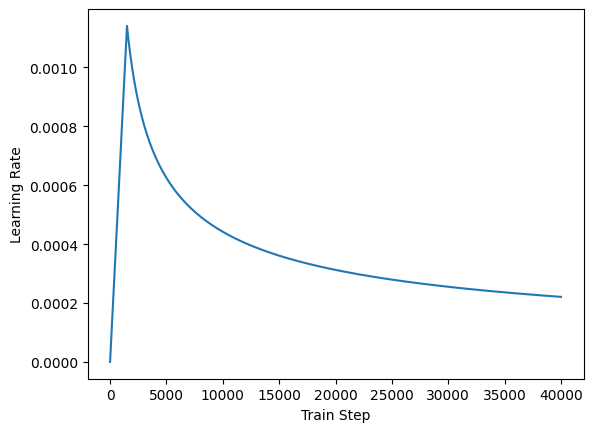

In [ ]:
plt.plot(learning_rate(tf.range(40000, dtype=tf.float32)))
plt.ylabel('Learning Rate')
plt.xlabel('Train Step')

## **9.4 Loss and Accuracy**

In [ ]:
def masked_loss(label, pred):
  mask = label != -1
  loss_object = tf.keras.losses.MeanSquaredError()
  loss = loss_object(label, pred)

  mask = tf.cast(mask, dtype=loss.dtype)
  loss *= mask

  loss = tf.reduce_sum(loss)/tf.reduce_sum(mask)
  return loss

## **9.5 Compile Model**

In [ ]:
transformer.compile(
    loss=masked_loss,
    optimizer=optimizer)

## **9.6 Delete Batch For Testing**

In [ ]:
del x_batch_train
del y_batch_train
del true_y_batch_train

# **10. Training**

## **10.1 Early Stopping**

In [ ]:
# Define early stopping callback
early_stopping_callback = EarlyStopping(
    patience=20,
    monitor='val_loss',
    restore_best_weights=True
)

## **10.2 TensorBoard**

In [ ]:
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

tensorboard_callback = tf.keras.callbacks.TensorBoard(
    log_dir=log_dir,
    histogram_freq=0,
    write_graph=False,
    update_freq=20
)

In [ ]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

## **10.3 Fit**

In [ ]:
# Fit the model using NumPy arrays
transformer.fit(train_dataset,
                epochs=NUM_EPOCHS,
                validation_data=test_dataset,
                callbacks=[early_stopping_callback, tensorboard_callback]
)

Epoch 1/250
20/20 [==============================] - 79s 1s/step - loss: 446.0847 - val_loss: 456.4976
Epoch 2/250
20/20 [==============================] - 5s 263ms/step - loss: 443.4206 - val_loss: 452.9379
Epoch 3/250
20/20 [==============================] - 5s 255ms/step - loss: 439.2408 - val_loss: 447.8953
Epoch 4/250
20/20 [==============================] - 5s 251ms/step - loss: 433.4005 - val_loss: 441.2703
Epoch 5/250
20/20 [==============================] - 5s 257ms/step - loss: 426.1864 - val_loss: 433.6412
Epoch 6/250
20/20 [==============================] - 5s 244ms/step - loss: 418.1904 - val_loss: 425.4580
Epoch 7/250
20/20 [==============================] - 5s 253ms/step - loss: 409.8527 - val_loss: 417.0967
Epoch 8/250
20/20 [==============================] - 5s 258ms/step - loss: 401.4698 - val_loss: 408.8176
Epoch 9/250
20/20 [==============================] - 5s 247ms/step - loss: 393.2710 - val_loss: 400.8025
Epoch 10/250
20/20 [==============================] - 5s 

# **11. Saving and Loading**

## **11.1 File Path**

In [ ]:
SAVE_FILE_PATH = os.path.join('drive', 'MyDrive', 'Data', "music_transformer_6_3_10")

## **11.2 Save Weights**

In [ ]:
transformer.save_weights(SAVE_FILE_PATH)

## **11.3 Load Weights**

In [ ]:
# Create a new Transformer model with the same architecture
new_transformer = Transformer(
    num_layers=NUM_LAYERS,
    d_model=D_MODEL,
    num_features=FEATURE_EMBEDDINGS,
    num_heads=NUM_HEADS,
    d_k=D_K,
    dff=D_FF,
    input_vocab_size=INPUT_VOCAB_SIZE,
    target_vocab_size=OUTPUT_VOCAB_SIZE,
    dropout_rate=DROPOUT_RATE)

# Compile the new model with the same optimizer and loss functions
new_transformer.compile(
    optimizer=optimizer,
    loss=masked_loss)

# Load the saved weights into the new model
new_transformer.load_weights(SAVE_FILE_PATH)

# **12. Running Inference**

## **12.1 Build Functions**

In [ ]:
def teacher_forcing_inference(x_batch, y_batch, true_y_batch, samples_to_use):
  x = x_batch[:samples_to_use, :, :]

  y = y_batch[:samples_to_use, :, :]

  true_y = true_y_batch[:samples_to_use, :, :]

  outputs = new_transformer((x, y), training=False)
  outputs = np.concatenate((outputs, np.zeros((np.shape(outputs)[0], TOKENS_TO_PREDICT, 8193-np.shape(outputs)[2]))), axis=2)

  inputs = np.concatenate((x, np.zeros((np.shape(x)[0], TOKENS_TO_PREDICT, 8193-np.shape(x)[2]))), axis=2)

  true_outputs = np.concatenate((true_y, np.zeros((np.shape(true_y)[0], TOKENS_TO_PREDICT, 8193-np.shape(true_y)[2]))), axis=2)

  return inputs, outputs, true_outputs

In [ ]:
def greedy_inference(x_batch, y_batch, true_y_batch, samples_to_use):
  x = x_batch[:samples_to_use, :, :]

  y = tf.zeros((samples_to_use, 0, np.shape(x)[2]), dtype=tf.float32)

  true_y = true_y_batch[:samples_to_use, :, :]

  for time in range(TOKENS_TO_PREDICT):
    pred = tf.expand_dims(new_transformer((x, y), training=False)[:, -1, :], axis=1)
    y = tf.concat((y, pred), axis=1)

  inputs = np.concatenate((x, np.zeros((np.shape(x)[0], TOKENS_TO_PREDICT, 8193-np.shape(x)[2]))), axis=2)

  outputs = y
  outputs = np.concatenate((outputs, np.zeros((np.shape(outputs)[0], TOKENS_TO_PREDICT, 8193-np.shape(outputs)[2]))), axis=2)

  true_outputs = np.concatenate((true_y, np.zeros((np.shape(true_y)[0], TOKENS_TO_PREDICT, 8193-np.shape(true_y)[2]))), axis=2)

  return inputs, outputs, true_outputs

In [ ]:
def griffin_lim(spectrogram, n_iters):
  # Initialize the phase randomly
  phase = tf.random.uniform(shape=spectrogram.shape, minval=-np.pi, maxval=np.pi, dtype=tf.float32)

  for i in range(n_iters):
    # Reconstruct complex data
    complex_data = tf.complex(spectrogram * tf.math.cos(phase), spectrogram * tf.math.sin(phase))

    # Perform inverse STFT with the current phase
    reconstructed_signal = tf.signal.inverse_stft(complex_data, frame_length=FRAME_LENGTH, frame_step=FRAME_STEP)

    # Update the phase using the angle of the reconstructed signal
    phase = tf.math.angle(tf.signal.stft(reconstructed_signal, frame_length=FRAME_LENGTH, frame_step=FRAME_STEP))

  return reconstructed_signal

In [ ]:
def train_sample_inference(train_dataset, SAMPLES_TO_INSPECT):
  # Grab Batch
  for (batch, ((x_batch_train, y_batch_train), true_y_batch_train)) in enumerate(train_dataset):
    break

  # Grab Samples
  inputs, outputs, true_outputs = teacher_forcing_inference(x_batch_train, y_batch_train, true_y_batch_train, SAMPLES_TO_INSPECT)

  # Denoising
  threshold = 0.01
  outputs[outputs < threshold] = 0.0

  # Plotting
  for sample in range(SAMPLES_TO_INSPECT):
    plt.imshow(np.log10(outputs[sample] + 0.0000001), aspect="auto")
    plt.title(f'Output Spectrogram for Train Sample {sample+1} - Teacher Forcing')
    plt.xlabel('Frequency')
    plt.ylabel('Time')
    plt.show()

  # Griffin-Lim
  input_audio = []
  output_audio = []
  true_output_audio = []

  for sample in range(SAMPLES_TO_INSPECT):
    input_audio.append(griffin_lim(inputs[sample], 1000))
    output_audio.append(griffin_lim(outputs[sample], 1000))
    true_output_audio.append(griffin_lim(true_outputs[sample], 1000))

## **12.2 Teacher Forcing**

### **12.2.1 Train Sample Inference**

In [ ]:
for (batch, ((x_batch_train, y_batch_train), true_y_batch_train)) in enumerate(train_dataset):
  break

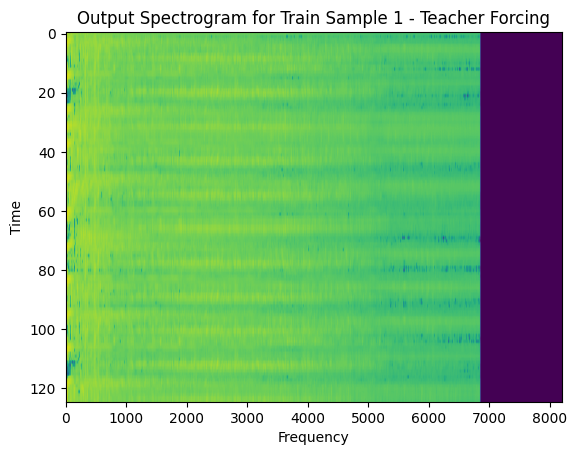

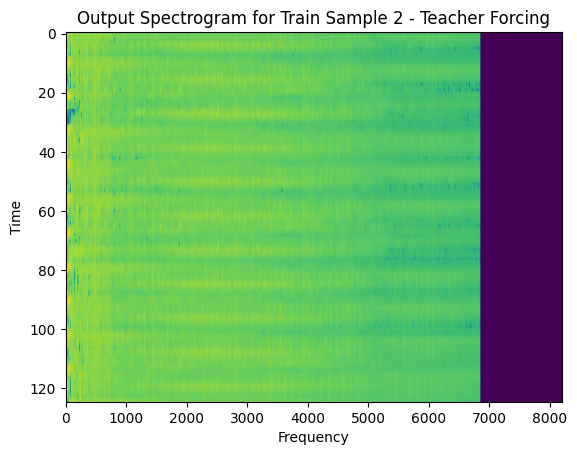

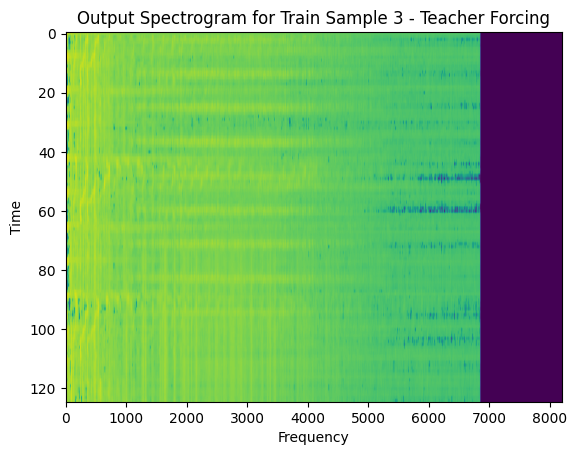

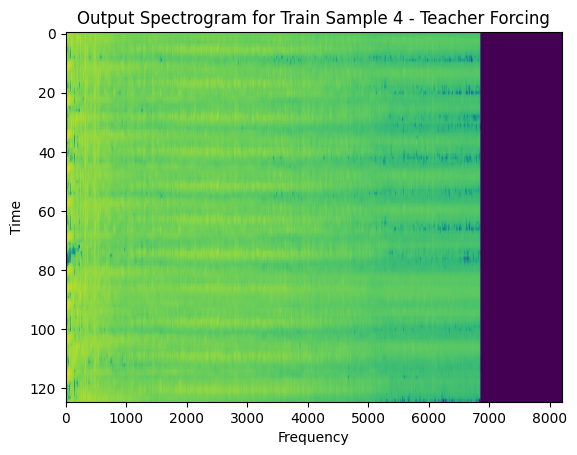

In [ ]:
# Grab Samples
SAMPLES_TO_INSPECT = 4
inputs, outputs, true_outputs = teacher_forcing_inference(x_batch_train, y_batch_train, true_y_batch_train, SAMPLES_TO_INSPECT)

# Denoising
threshold = 0.01
outputs[outputs < threshold] = 0.0

# Plotting
for sample in range(SAMPLES_TO_INSPECT):
  plt.imshow(np.log10(outputs[sample] + 0.0000001), aspect="auto")
  plt.title(f'Output Spectrogram for Train Sample {sample+1} - Teacher Forcing')
  plt.xlabel('Frequency')
  plt.ylabel('Time')
  plt.show()

# Griffin-Lim
input_audio = []
output_audio = []
true_output_audio = []

for sample in range(SAMPLES_TO_INSPECT):
  input_audio.append(griffin_lim(inputs[sample], 1000))
  output_audio.append(griffin_lim(outputs[sample], 1000))
  true_output_audio.append(griffin_lim(true_outputs[sample], 1000))

### **12.2.2 Train Sample EAR TEST**

In [ ]:
from IPython.display import Audio, display

for sample in range(SAMPLES_TO_INSPECT):
  print(f'\033[1mTRAIN SAMPLE {sample+1}\033[0m\n')

  print('Input Audio:')
  display(Audio(input_audio[sample].numpy(), rate=48000, autoplay=False))

  print('Model Predicted Audio:')
  display(Audio(output_audio[sample].numpy(), rate=48000, autoplay=False))

  print('True Output Audio:')
  display(Audio(true_output_audio[sample].numpy(), rate=48000, autoplay=False))
  print('\n\n')

del Audio, display

SAMPLE 1

Input Audio:


Model Predicted Audio:


True Output Audio:





SAMPLE 2

Input Audio:


Model Predicted Audio:


True Output Audio:





SAMPLE 3

Input Audio:


Model Predicted Audio:


True Output Audio:





SAMPLE 4

Input Audio:


Model Predicted Audio:


True Output Audio:


### **12.2.3 Test Sample Inference**

In [76]:
for (batch, ((x_batch_test, y_batch_test), true_y_batch_test)) in enumerate(test_dataset):
  break

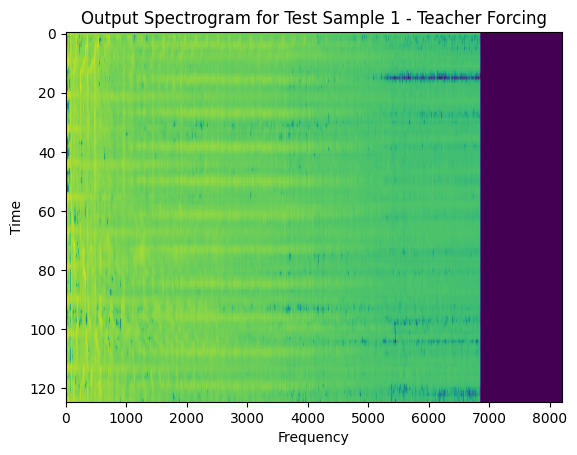

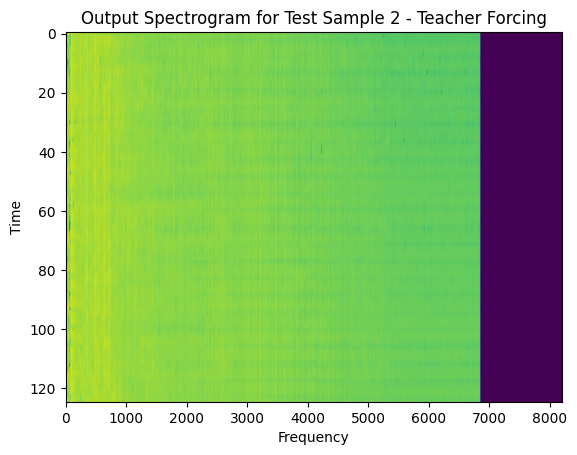

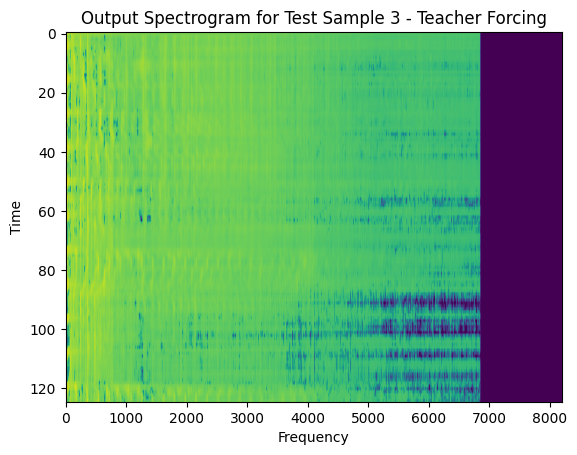

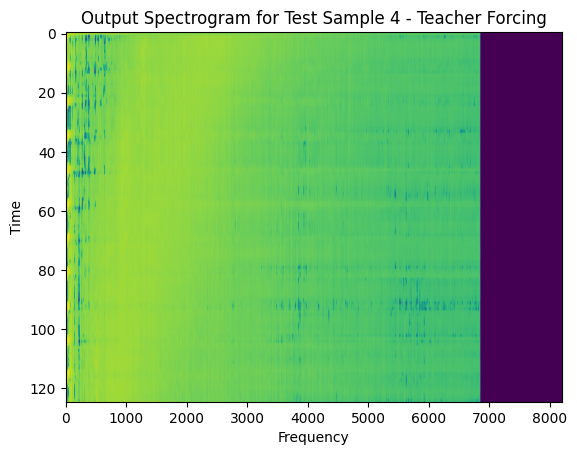

In [77]:
# Grab Samples
SAMPLES_TO_INSPECT = 4
inputs, outputs, true_outputs = teacher_forcing_inference(x_batch_test, y_batch_test, true_y_batch_test, SAMPLES_TO_INSPECT)

# Denoising
threshold = 0.01
outputs[outputs < threshold] = 0.0

# Plotting
for sample in range(SAMPLES_TO_INSPECT):
  plt.imshow(np.log10(outputs[sample] + 0.0000001), aspect="auto")
  plt.title(f'Output Spectrogram for Test Sample {sample+1} - Teacher Forcing')
  plt.xlabel('Frequency')
  plt.ylabel('Time')
  plt.show()

# Griffin-Lim
input_audio = []
output_audio = []
true_output_audio = []

for sample in range(SAMPLES_TO_INSPECT):
  input_audio.append(griffin_lim(inputs[sample], 1000))
  output_audio.append(griffin_lim(outputs[sample], 1000))
  true_output_audio.append(griffin_lim(true_outputs[sample], 1000))

### **12.2.4 Test Sample EAR TEST**

In [78]:
from IPython.display import Audio, display

for sample in range(SAMPLES_TO_INSPECT):
  print(f'\033[1mTEST SAMPLE {sample+1}\033[0m\n')

  print('Input Audio:')
  display(Audio(input_audio[sample].numpy(), rate=48000, autoplay=False))

  print('Model Predicted Audio:')
  display(Audio(output_audio[sample].numpy(), rate=48000, autoplay=False))

  print('True Output Audio:')
  display(Audio(true_output_audio[sample].numpy(), rate=48000, autoplay=False))
  print('\n\n')

del Audio, display

TEST SAMPLE 1

Input Audio:


Model Predicted Audio:


True Output Audio:





TEST SAMPLE 2

Input Audio:


Model Predicted Audio:


True Output Audio:





TEST SAMPLE 3

Input Audio:


Model Predicted Audio:


True Output Audio:





TEST SAMPLE 4

Input Audio:


Model Predicted Audio:


True Output Audio:


## **12.3 Greedy Inference - To Be Implemented**